# The Power of Context: Random Forest Classification of Near Synonyms

## A Case Study in Modern Hindi

**Author:** Jacek Bąkowski  
**Affiliation:** Institute of Polish Language, Polish Academy of Sciences  
**Email:** [jacek.bakowski@ijp.pan.pl](mailto:jacek.bakowski@ijp.pan.pl)  
**ORCID:** [0000-0003-2480-3396](https://orcid.org/0000-0003-2480-3396)  
**Journal:** *Journal of Quantitative Linguistics*  
**Year:** 2025

**Funding:** This work was funded by the National Science Centre, Poland, grant number 2021/43/O/HS2/02392

---

### Abstract
This notebook accompanies the research article examining the effectiveness of Random Forest classifiers in distinguishing between Perso-Arabic and Sanskrit near-synonyms in Modern Hindi, leveraging Word2Vec embeddings and contextual information.

## Import Libraries and Load Data:

In [141]:
# Standard library imports
import os
from collections import defaultdict
from random import sample
from warnings import simplefilter

# Third-party imports
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import shap
import sklearn.exceptions
import umap
from gensim.models import Word2Vec as MODEL
from matplotlib.legend_handler import HandlerLine2D
from matplotlib.pyplot import figure
from prettytable import PrettyTable
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.tree import plot_tree
from tqdm import tqdm
from yellowbrick.classifier import ClassificationReport

# Local application imports
from toolbox import load_model, plot_model_efficiency, display_errors, analyze_errors, plot_word_proportions, plot_data_distributions, display_shap, display_correlation_matrix, display_jaccard_indexes

# Suppress warnings
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)
simplefilter(action="ignore", category=pd.errors.SettingWithCopyWarning)
simplefilter(action="ignore", category=sklearn.exceptions.UndefinedMetricWarning)

In [142]:
# Import of the list of Perso-Arabic / Sanskrit synonyms
from vocab_large import RawVocabulary

Vocabulary = RawVocabulary()
synonym_list = Vocabulary.synonym_list
Vocabulary.display_stats()

+---------------------------------------------------------------------------------------------------------------------------------------------+
|                                                        Raw Vocabulary Specifications                                                        |
+-----------------------+---------------------------+----------------+--------------------+-----------------+-------+------+------+-----------+
| Raw vocabulary length | Number of Unique Meanings | Sanskrit Words | Perso-Arabic Words | SKRT + PA Words | Nouns | Adj. | Ppos | Other POS |
+-----------------------+---------------------------+----------------+--------------------+-----------------+-------+------+------+-----------+
|          270          |            135            |      135       |        135         |       270       |  203  |  41  |  6   |     20    |
+-----------------------+---------------------------+----------------+--------------------+-----------------+-------+------+------+-----

In [143]:
# Converting synonym list into pandas dataframe
raw_vocabulary = Vocabulary.convert_to_df()
raw_vocabulary

,Word,Meaning,Origin,POS
0,मुताबिक़,according to,PA,ppos
1,अनुसार,according to,SKRT,ppos
2,फ़ायदा,"advantage, benefit",PA,noun
3,लाभ,"advantage, benefit",SKRT,noun
4,सलाह,advice,PA,noun
...,...,...,...,...
265,महिला,woman,SKRT,noun
266,लफ़्ज़,word,PA,noun
267,शब्द,word,SKRT,noun
268,साल,year,PA,noun


## Load the W2V Model

In [ ]:
##################################################################
# Here put your working directory and the name of your W2V model #
##################################################################
## Below put your working directory:
os.chdir('.')
## and here the name of your model file:

MODEL_FILE = "models/hindi/bombay_corpus_200.model"
##################################################################

# Load the Word2Vec model using the function from toolbox
model_loaded = load_model(MODEL_FILE)

+-------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|                                                                      W2V Model Specifications                                                                     |
+-------------+--------------+--------------------+-----------+---------------------+--------+------------------+---------------------------------------------------+
| Vector Size | Corpus count | Corpus total words | Min count | Effective min count | Epochs | Total train time |                      Filename                     |
+-------------+--------------+--------------------+-----------+---------------------+--------+------------------+---------------------------------------------------+
|     200     |  44,961,646  |    752,508,532     |     10    |          10         |   5    |     4519.10s     | bombay_corpus_hindi_word2vec_200_27_10_2024.model |
+---

## Build the Embeddings

In [145]:
bombay_embeddings, embedding_cols, embeddings_mapping_dict = Vocabulary.build_embeddings(raw_vocabulary, model_loaded)
bombay_embeddings = Vocabulary.add_similarity_freq_diff(bombay_embeddings, model_loaded)

+-------------------------------------------------------------------------------------------------+
|                                  Embedding Computation Summary                                  |
+----------------+----------------------+-------------------------+--------------+----------------+
| Raw Vocabulary | Number of embeddings | No embeddings found for | After dropna | Overall result |
+----------------+----------------------+-------------------------+--------------+----------------+
|   270 words    |      270 words       |         0 words         |     270      |       OK       |
+----------------+----------------------+-------------------------+--------------+----------------+
+----------------------------------------------+
| Summary for similarity computation: 0 errors |
+--------------------+-------------------------+
|        Word        |          Error          |
+--------------------+-------------------------+
+--------------------+-------------------------+


In [146]:
bombay_embeddings.head(10)

,Word,Meaning,Origin,Origin_code,POS,Similarity,Freq,Freq_diff,0,1,...,190,191,192,193,194,195,196,197,198,199
0,मुताबिक़,according to,PA,0,ppos,0.888792,134559,-180712,-0.823102,2.111590,...,2.236682,-2.841212,0.112583,-2.057538,-2.362419,-2.888785,-3.650364,0.311890,0.230718,-0.777986
1,अनुसार,according to,SKRT,1,ppos,0.888792,315271,180712,-0.708375,1.285159,...,0.485142,-3.224078,-0.217975,-2.676085,-0.267757,-2.144358,-4.470402,0.347183,0.428601,-0.299248
2,फ़ायदा,"advantage, benefit",PA,0,noun,0.748019,70485,-88816,-1.875654,-0.091321,...,-0.110155,-3.856297,2.276298,-1.017168,-4.102366,-2.202073,1.243956,2.552790,0.383542,1.660420
3,लाभ,"advantage, benefit",SKRT,1,noun,0.748019,159301,88816,-2.830454,0.042213,...,-2.968432,-2.805713,0.715712,-0.490747,-2.203360,-2.418743,0.726932,3.694897,0.722001,2.838319
4,सलाह,advice,PA,0,noun,0.458623,70317,68312,-0.405784,4.095425,...,-5.040421,-0.288125,-1.500565,-3.427109,1.959271,-4.024116,-1.864051,-0.251147,2.019495,1.216787
5,सम्मति,advice,SKRT,1,noun,0.458623,2005,-68312,-1.138924,2.205122,...,-4.258890,0.439274,-1.183404,-2.466198,1.610917,1.027285,-0.705071,0.221266,-1.542292,2.510487
6,ख़िलाफ़,against,PA,0,ppos,0.485061,293696,120594,-4.133389,0.658015,...,2.756305,0.498635,0.964041,-2.416011,2.082150,-1.169694,-0.065994,2.033769,-0.556255,0.345794
7,विरोध,against,SKRT,1,ppos,0.485061,173102,-120594,-3.650904,0.796525,...,2.405693,-1.717246,1.561909,-0.814622,1.341522,0.426760,1.167670,1.678947,0.177638,2.976579
8,क़बूल,agreement,PA,0,noun,0.079272,8287,-32046,-1.496126,-0.076017,...,-0.222717,-1.486342,-3.063734,-5.290855,2.071243,-2.458565,-2.118152,1.438000,0.791763,-0.288682
9,सहमति,agreement,SKRT,1,noun,0.079272,40333,32046,-1.968308,5.011074,...,-2.725001,0.077875,-1.279619,-1.199757,2.334595,1.026308,-1.237861,1.914250,3.058547,4.112203


## Data Exploration

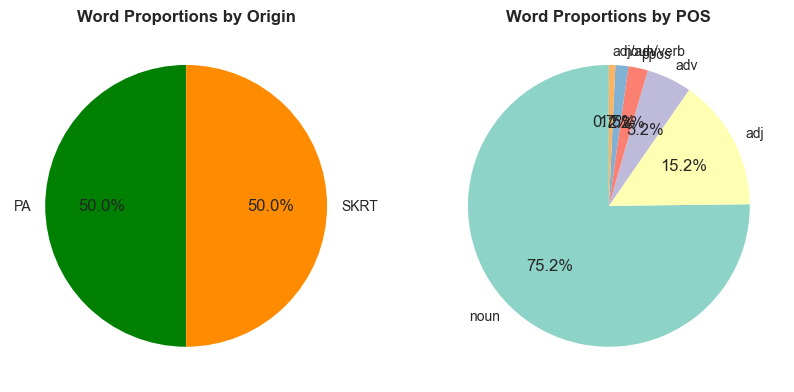

In [147]:
plot_word_proportions(bombay_embeddings)

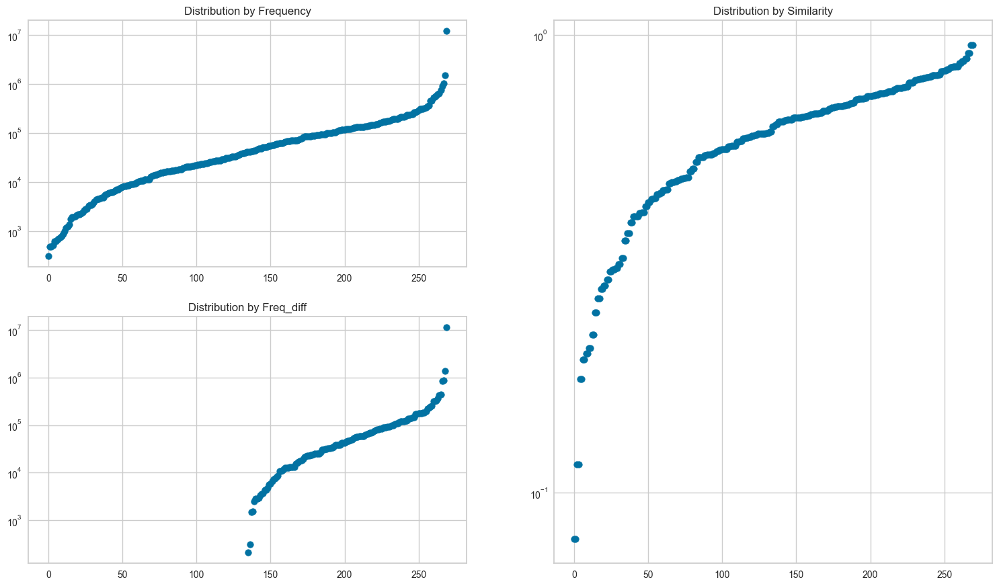

In [148]:
plot_data_distributions(bombay_embeddings)

## Single Random Forest

In [149]:
#########################################################
#                                                       #
#            P R O O F  O F  C O N C E P T              #
#      R A N D O M  F O R E S T  C L A S S I F I E R    #
#                                                       #
#########################################################

def single_random_forest(embeddings, embedding_cols, n_estimators=50, criterion='gini', max_depth=10, oob_score=True, warm_start=True):
    data_train = embeddings.sample(frac = 0.80)
    X_train_single_rf = data_train[embedding_cols]
    y_train_single_rf = data_train["Origin_code"]

    data_test = embeddings.drop(data_train.index)
    X_test_single_rf = data_test[embedding_cols]
    y_test_single_rf = data_test["Origin_code"]
    
    single_rf = RandomForestClassifier(n_estimators=n_estimators, criterion='gini', max_depth=max_depth)
    single_rf.fit(X_train_single_rf, y_train_single_rf)
    y_pred_single_rf = single_rf.predict(X_test_single_rf)
    labels = list(embeddings_mapping_dict.values())
    report = classification_report(y_test_single_rf, y_pred_single_rf, target_names = labels, output_dict=True)
    single_rf.report = { 'accuracy': report['accuracy'],
                        'precision_score_PA' : report['PA']['precision'],
                        'recall_score_PA' : report['PA']['recall'],
                        'f1_score_PA' : report['PA']['f1-score'],
                        'precision_score_SKRT' : report['SKRT']['precision'],
                        'recall_score_SKRT' : report['SKRT']['recall'],
                        'f1_score_SKRT' : report['SKRT']['f1-score'],
                        }
    single_rf.accuracy = single_rf.report['accuracy']
    single_rf.X_train = X_train_single_rf
    single_rf.y_train = y_train_single_rf
    single_rf.X_test = X_test_single_rf
    single_rf.y_test = y_test_single_rf
    single_rf.accuracy = single_rf.report['accuracy']
    return single_rf

In [150]:
# Train and evaluate single Random Forest classifier
single_rf = single_random_forest(bombay_embeddings, embedding_cols)
print(f'Accuracy of the Random Forest classifier: {single_rf.accuracy:.4f}')
print(f'Training set size: {len(single_rf.X_train)} samples')
print(f'Test set size: {len(single_rf.X_test)} samples')

# Display the structure of the first decision tree (truncated for readability)
single_tree = single_rf.estimators_[0]
text_representation = tree.export_text(single_tree, max_depth=3)  # Limit depth for readability
print(f'\nFirst Decision Tree Structure (max_depth=3):')
print(text_representation)

Accuracy of the Random Forest classifier: 0.9259
Training set size: 216 samples
Test set size: 54 samples

First Decision Tree Structure (max_depth=3):
|--- feature_156 <= -1.36
|   |--- feature_150 <= 1.52
|   |   |--- feature_24 <= 3.70
|   |   |   |--- feature_87 <= -2.01
|   |   |   |   |--- truncated branch of depth 2
|   |   |   |--- feature_87 >  -2.01
|   |   |   |   |--- class: 0.0
|   |   |--- feature_24 >  3.70
|   |   |   |--- class: 1.0
|   |--- feature_150 >  1.52
|   |   |--- feature_110 <= -0.86
|   |   |   |--- class: 0.0
|   |   |--- feature_110 >  -0.86
|   |   |   |--- class: 1.0
|--- feature_156 >  -1.36
|   |--- feature_62 <= -1.07
|   |   |--- feature_133 <= -1.60
|   |   |   |--- class: 1.0
|   |   |--- feature_133 >  -1.60
|   |   |   |--- feature_174 <= -1.51
|   |   |   |   |--- class: 1.0
|   |   |   |--- feature_174 >  -1.51
|   |   |   |   |--- truncated branch of depth 3
|   |--- feature_62 >  -1.07
|   |   |--- feature_59 <= 0.58
|   |   |   |--- feature

/Users/jacek_bakowski/Desktop/Publikacje/The Power of Context/The-Power-of-Context/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


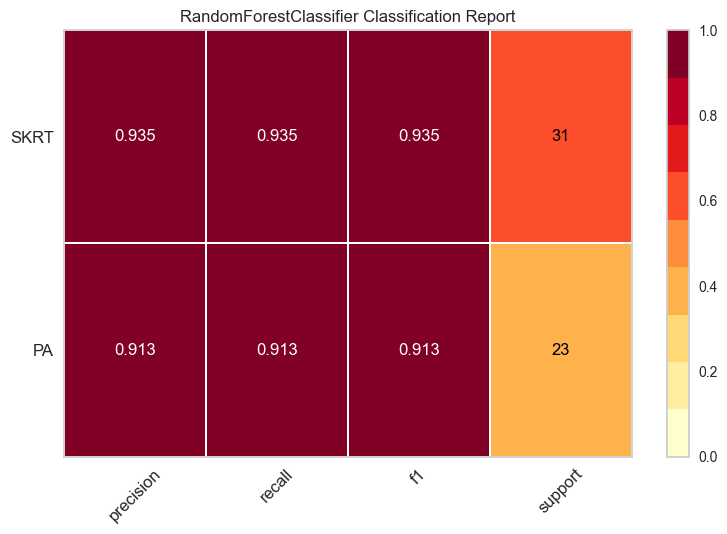

<Axes: title={'center': 'RandomForestClassifier Classification Report'}>

In [151]:
# Visualize classification report using YellowBrick
labels = list(embeddings_mapping_dict.values())
visualizer = ClassificationReport(single_rf, classes=labels, support=True)

# Fit the visualizer and evaluate the model
visualizer.fit(single_rf.X_train, single_rf.y_train)
score = visualizer.score(single_rf.X_test, single_rf.y_test)
visualizer.show()

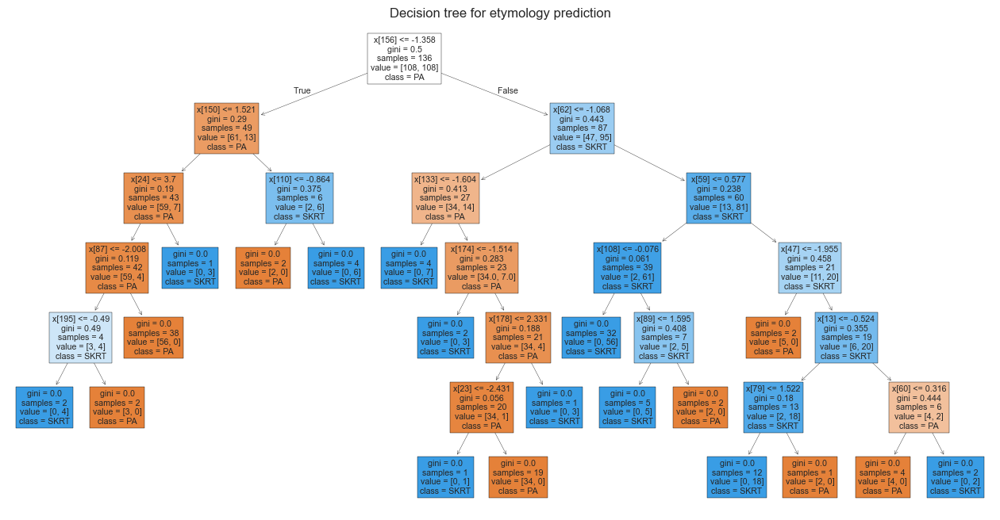

In [152]:
# Visualize a single decision tree from the Random Forest
plt.figure(figsize=(16,8))
plot_tree(single_rf.estimators_[0], filled=True, class_names=['PA', 'SKRT'])
plt.title("Decision tree for etymology prediction")
plt.show()

## SHAP Values for the Random Forest Classifier

In [153]:
# SHAP explainer for the single Random Forest classifier
single_rf_explainer = shap.TreeExplainer(single_rf)
shap_values = single_rf_explainer.shap_values(single_rf.X_test)
display_shap(shap_values, single_rf.X_test, grayscale=False, xlabel='SHAP values — Feature impact on model output')

In [154]:
# Grayscale version for print publication
display_shap(shap_values, single_rf.X_test, grayscale=True, xlabel='SHAP values — Feature impact on model output')

## Tuning the Model

In [155]:
#########################################################
#                                                       #
#          E F F I C I E N C Y  A N A L Y S Y S         #
#             M A X  D E P T H  I M P A C T             #
#                                                       #
#########################################################
# Testing the impact of the max depth parameter of each tree on the model's total accuracy with a cumulative run
# For each value of max_depth, the model is run number_of_runs times and the average accuracy is computed
# We see that max_depth = 5 seems to be the correct set up and this parameter will be used after

max_depth = 50
number_of_runs = 100
total_results_max_depth = defaultdict(list)


for depth in tqdm(range(1, max_depth+1), colour='yellow'):
    total_report = defaultdict(int)
    for run in range(0, number_of_runs):
        single_rf = single_random_forest(bombay_embeddings, embedding_cols, n_estimators=50, criterion='gini', max_depth=depth)
        total_report = {k: total_report[k] + single_rf.report[k] for k in total_report.keys() | single_rf.report.keys()}
        
    [ total_results_max_depth[k].append(total_report[k] / number_of_runs) for k in total_report.keys() ]

plot_model_efficiency(max_depth+1, 'Max Depth', 'Model efficiency regarding the max depth of the trees', total_results_max_depth)

 56%|█████▌    | 28/50 [02:54<02:16,  6.23s/it]


KeyboardInterrupt: 

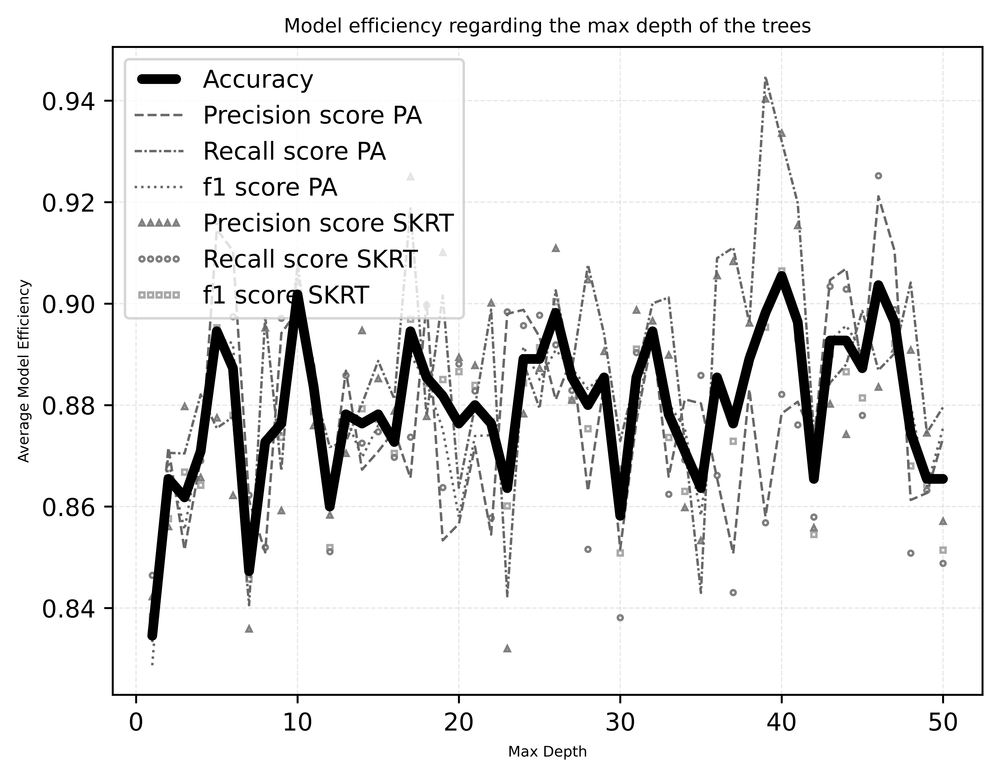

In [ ]:
# Grayscale version for print publication
plot_model_efficiency(max_depth+1, 'Max Depth', 'Model efficiency regarding the max depth of the trees', total_results_max_depth, grayscale=True)

100%|██████████| 200/200 [03:39<00:00,  1.10s/it]


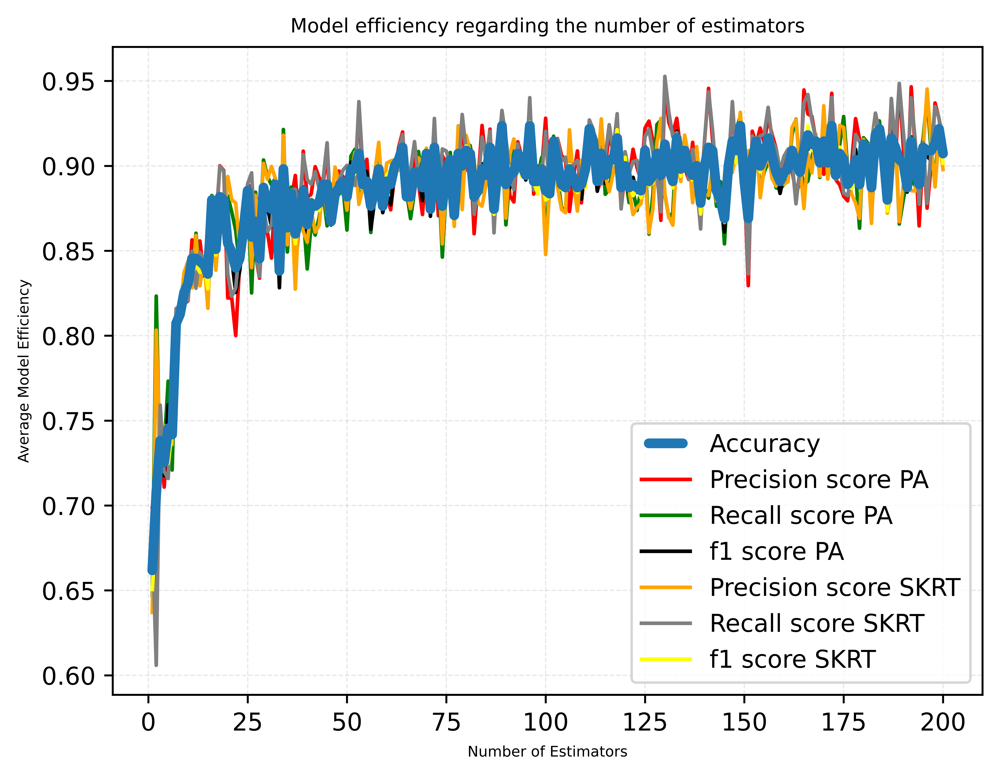

In [ ]:
##########################################################
#                                                        #
#          E F F I C I E N C Y  A N A L Y S Y S          #
#   N U M B E R  O F  E S T I M A T O R S  I M P A C T   #
#                                                        #
##########################################################
# We will increase the number of estimators (i.e. trees in each model) and check its impact on the model's accuracy
# For each value of max_nb_trees, the model is run number_of_runs times and the average accuracy is computed
# We see that max_nb_trees = 50 seems to be the correct set up and this parameter will be used after

max_nb_trees = 200
number_of_runs = 100
total_results_number_of_estimators = defaultdict(list)


for nb_trees in tqdm(range(1, max_nb_trees+1), colour='yellow'):
    total_report = defaultdict(int)
    
    for _ in range(number_of_runs):
        single_rf = single_random_forest(bombay_embeddings, embedding_cols, n_estimators=nb_trees, criterion='gini', max_depth=5)
        total_report = {k: total_report[k] + single_rf.report[k] for k in total_report.keys() | single_rf.report.keys()}
    
    [ total_results_number_of_estimators[k].append(total_report[k] / number_of_runs) for k in total_report.keys() ]

plot_model_efficiency(max_nb_trees + 1, 'Number of Estimators', 'Model efficiency regarding the number of estimators', total_results_number_of_estimators)

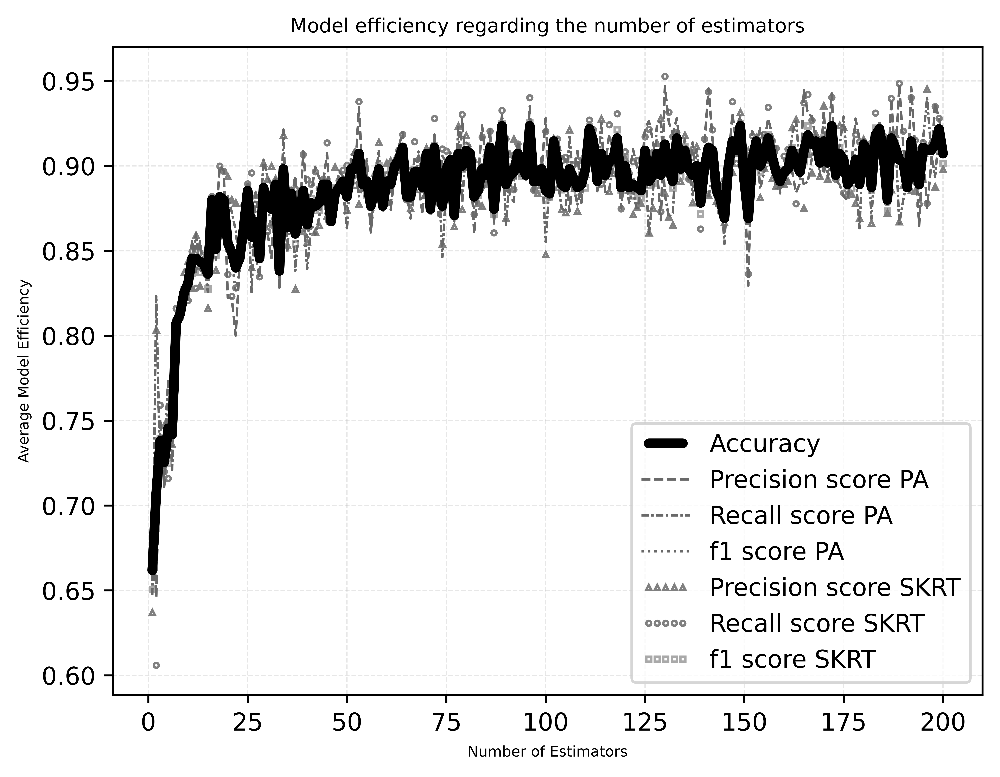

In [ ]:
# Grayscale version for print publication
plot_model_efficiency(max_nb_trees + 1, 'Number of Estimators', 'Model efficiency regarding the number of estimators', total_results_number_of_estimators, grayscale=True)

100%|██████████| 100/100 [00:11<00:00,  8.36it/s]


Text(0.5, 0, 'Run Number')

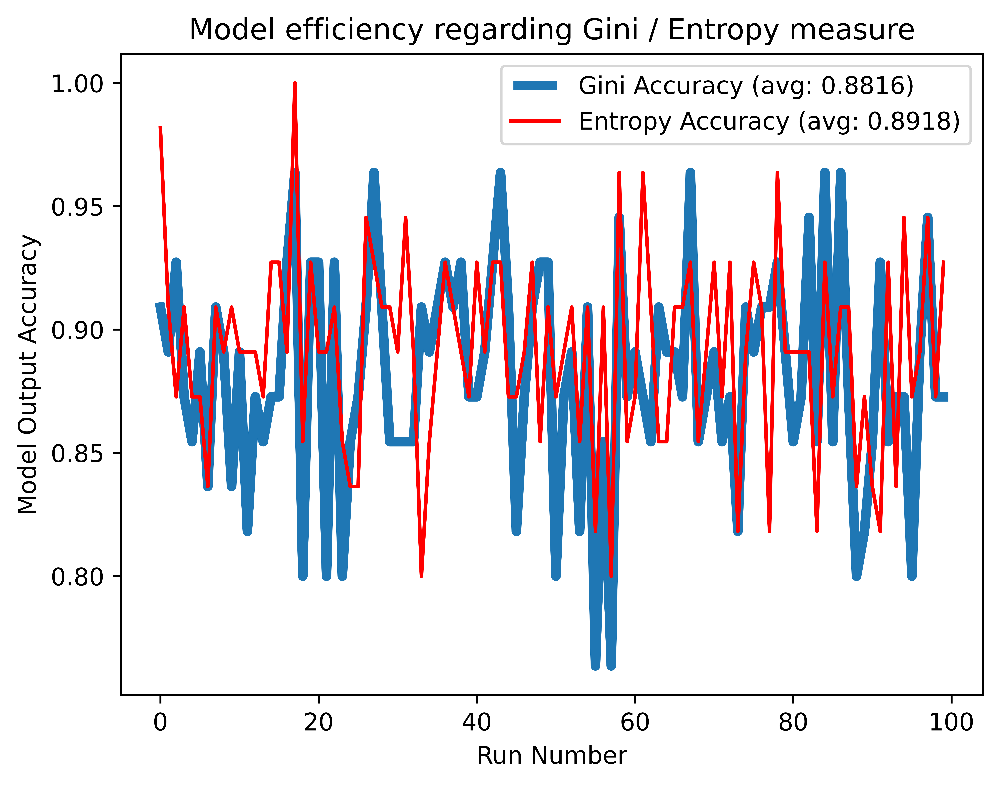

In [ ]:
#########################################################
#                                                       #
#          E F F I C I E N C Y  A N A L Y S Y S         #
#           G I N I  V S  E N T R O P Y  T E S T        #
#                                                       #
#########################################################
# We will check the accuracy difference between the Gini and Entropy (log_loss) measures

accuracy_results_gini = []
accuracy_results_entropy = []
number_of_runs = 100
    
for run in tqdm(range(number_of_runs), colour='yellow'): 
    # Split data for this run
    data_train = bombay_embeddings.sample(frac = 0.80)
    X_train_single_rf = data_train[embedding_cols]
    y_train_single_rf = data_train["Origin_code"]

    data_test = bombay_embeddings.drop(data_train.index)
    X_test_single_rf = data_test[embedding_cols]
    y_test_single_rf = data_test["Origin_code"]

    # Train both models
    single_rf_gini = RandomForestClassifier(n_estimators=50, criterion='gini', max_depth=5)
    single_rf_entropy = RandomForestClassifier(n_estimators=50, criterion='entropy', max_depth=5)
    
    single_rf_gini.fit(X_train_single_rf, y_train_single_rf)
    single_rf_entropy.fit(X_train_single_rf, y_train_single_rf)
    
    # Make predictions and calculate accuracy
    y_pred_gini = single_rf_gini.predict(X_test_single_rf)
    y_pred_entropy = single_rf_entropy.predict(X_test_single_rf)

    accuracy_gini = accuracy_score(y_test_single_rf, y_pred_gini)
    accuracy_entropy = accuracy_score(y_test_single_rf, y_pred_entropy)
    
    accuracy_results_gini.append(accuracy_gini)
    accuracy_results_entropy.append(accuracy_entropy)

# Plot comparison
plt.figure(dpi=1200)
line1, = plt.plot(range(number_of_runs), accuracy_results_gini, color="#1f77b4", 
                  label=f"Gini Accuracy (avg: {sum(accuracy_results_gini) / number_of_runs:.4f})", linewidth=4)
line2, = plt.plot(range(number_of_runs), accuracy_results_entropy, color="r", 
                  label=f"Entropy Accuracy (avg: {sum(accuracy_results_entropy) / number_of_runs:.4f})")

plt.title('Model efficiency regarding Gini / Entropy measure')
plt.legend(handler_map={line1: HandlerLine2D(numpoints=2)})
plt.ylabel('Model Output Accuracy')
plt.xlabel('Run Number')

100%|██████████| 200/200 [01:35<00:00,  2.10it/s]


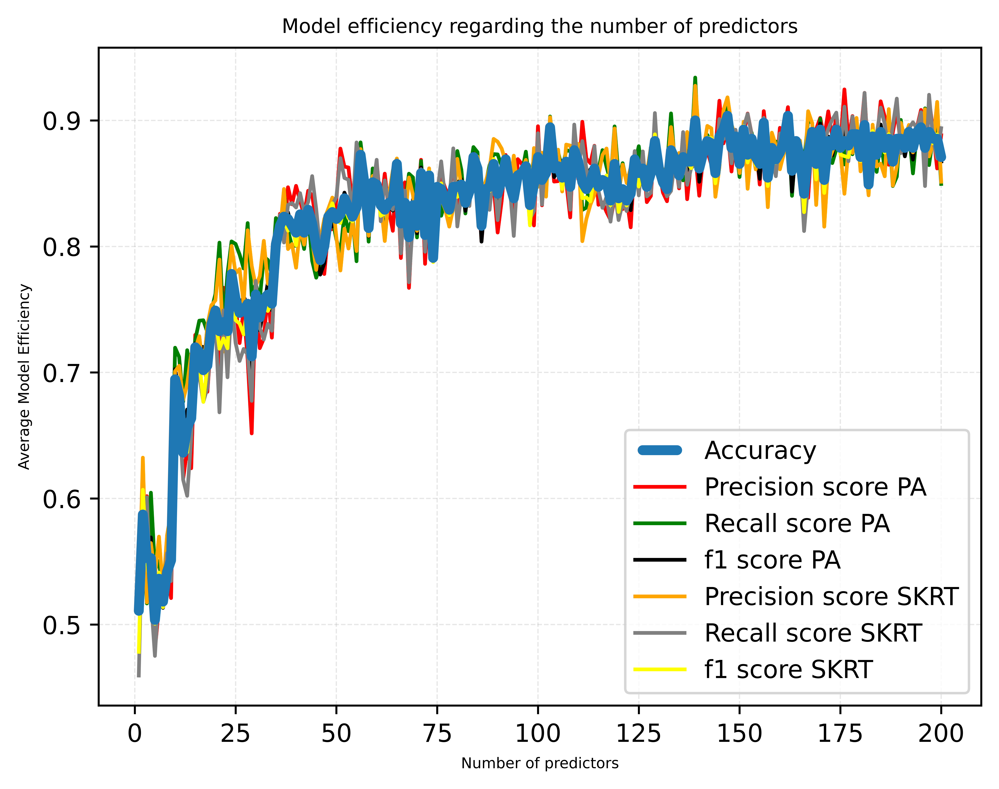

In [ ]:
#########################################################
#                                                       #
#          E F F I C I E N C Y  A N A L Y S Y S         #
#         N U M B E R  O F  P R E D I C T O R S         #
#                                                       #
#########################################################
# Testing model accuracy with a limited number of predictors
# Number of predictors (i.e. of vector dimensions, that is number of columns in the data frame) will be increased at each loop gradually
# For each value of predictors, the model is run number_of_runs times and the average accuracy is computed

number_of_runs = 100
max_predictors = 200
total_results_number_of_predictors = defaultdict(list)

for num_predictors in tqdm(range(1, max_predictors + 1), colour='yellow'):
    # Create list of embedding column names for current number of predictors
    temp_embedding_cols = list(range(0, num_predictors))
    temp_embedding_cols = list(map(str, temp_embedding_cols))
    
    total_report = defaultdict(int)
    for run in range(0, number_of_runs):   
        single_rf = single_random_forest(bombay_embeddings, embedding_cols=temp_embedding_cols, n_estimators=50, criterion='gini', max_depth=5)
        total_report = {k: total_report[k] + single_rf.report[k] for k in total_report.keys() | single_rf.report.keys()}

    [ total_results_number_of_predictors[k].append(total_report[k] / number_of_runs) for k in total_report.keys() ]

plot_model_efficiency(max_predictors + 1, 'Number of predictors', 'Model efficiency regarding the number of predictors', total_results_number_of_predictors)

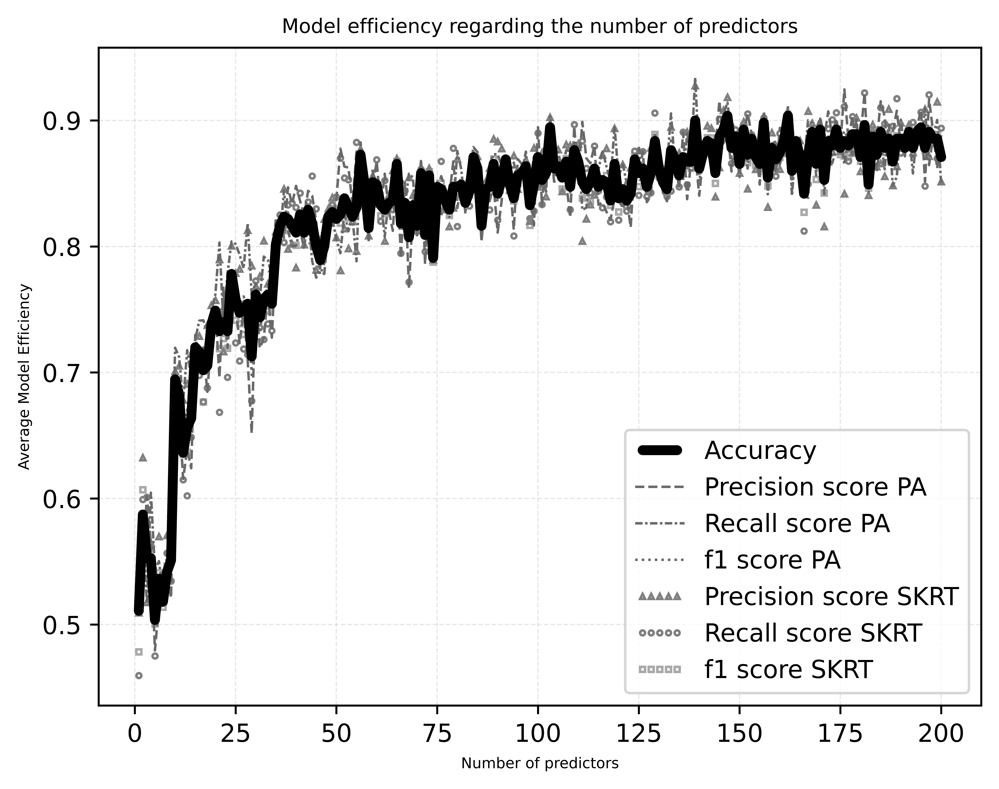

In [ ]:
# Grayscale version for print publication
plot_model_efficiency(max_predictors + 1, 'Number of predictors', 'Model efficiency regarding the number of predictors', total_results_number_of_predictors, grayscale=True)

100%|██████████| 200/200 [01:38<00:00,  2.03it/s]


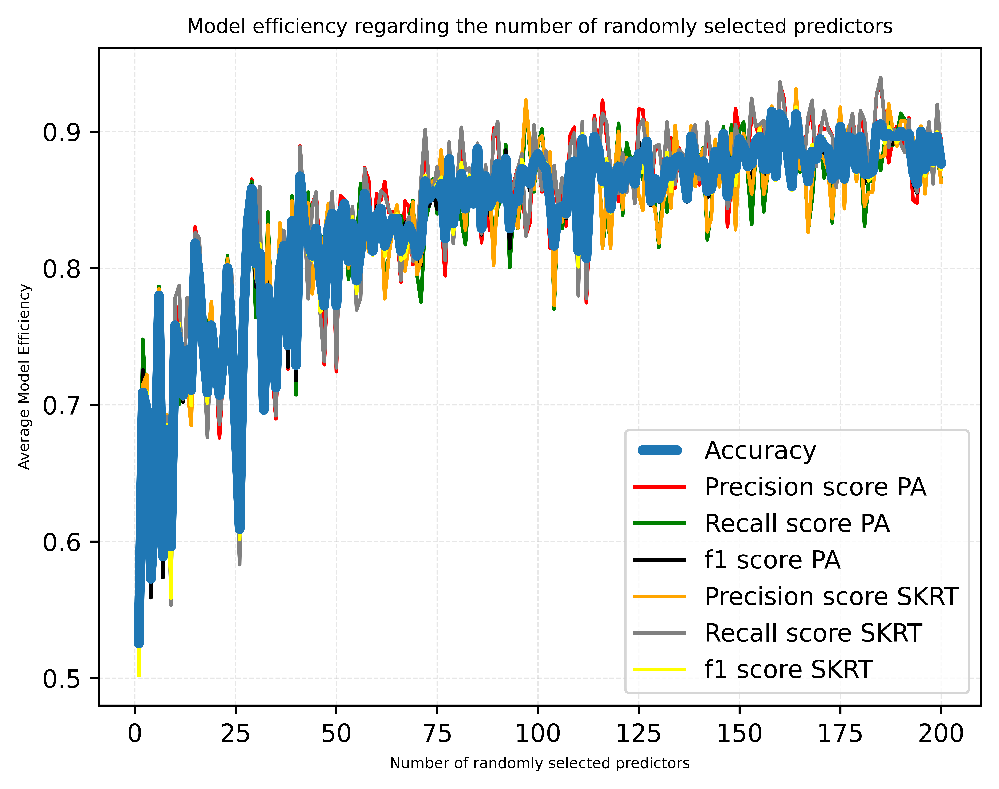

In [ ]:
###########################################################
#                                                         #
#          E F F I C I E N C Y  A N A L Y S Y S           #
#  R A N D O M L Y  S E L E C T E D  P R E D I C T O R S  #
#                                                         #
###########################################################
# Testing model accuracy with randomly selected predictors
# For each number of predictors, we randomly sample that many columns from all available embedding columns
# For each value of predictors, the model is run number_of_runs times and the average accuracy is computed

number_of_runs = 100
max_predictors = 200
total_results_random_predictors = defaultdict(list)

for num_predictors in tqdm(range(1, max_predictors + 1), colour='yellow'):
    # Randomly sample embedding columns for current number of predictors
    random_cols = sample(embedding_cols, num_predictors)
    
    total_report = defaultdict(int)
    for run in range(0, number_of_runs):   
        single_rf = single_random_forest(bombay_embeddings, embedding_cols=random_cols, n_estimators=50, criterion='gini', max_depth=5)
        total_report = {k: total_report[k] + single_rf.report[k] for k in total_report.keys() | single_rf.report.keys()}

    [ total_results_random_predictors[k].append(total_report[k] / number_of_runs) for k in total_report.keys() ]

plot_model_efficiency(max_predictors + 1, 'Number of randomly selected predictors', 'Model efficiency regarding the number of randomly selected predictors', total_results_random_predictors)

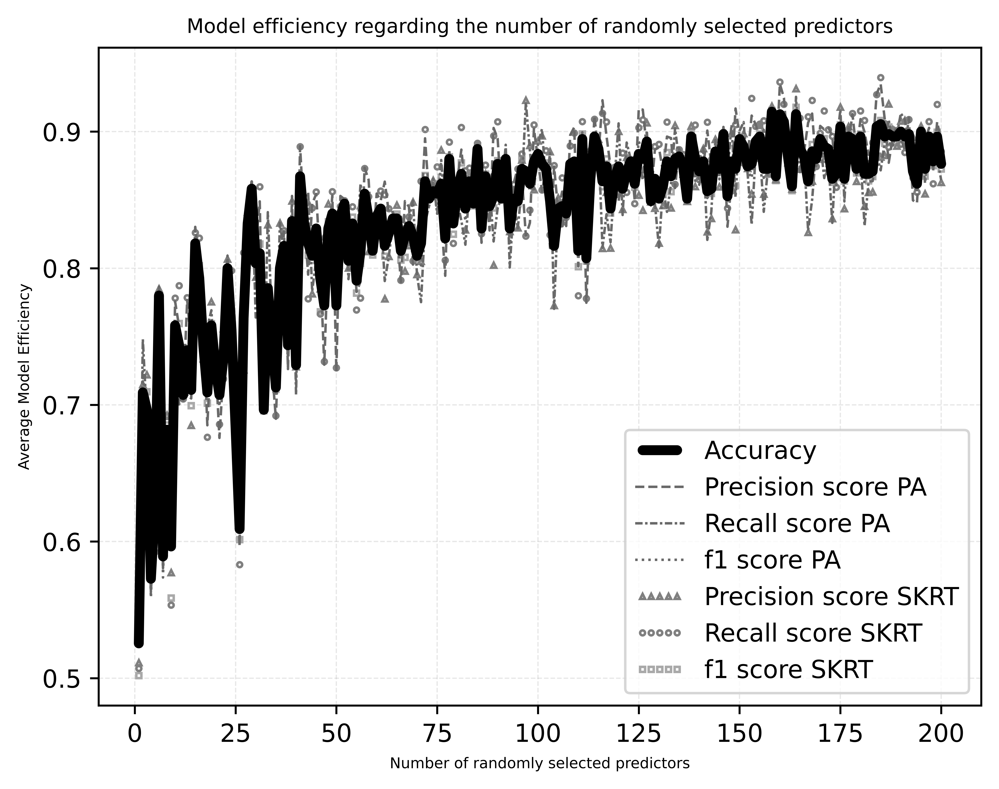

In [ ]:
# Grayscale version for print publication
plot_model_efficiency(max_predictors + 1, 'Number of randomly selected predictors', 'Model efficiency regarding the number of randomly selected predictors', total_results_random_predictors, grayscale=True)

100%|██████████| 128/128 [00:59<00:00,  2.17it/s]


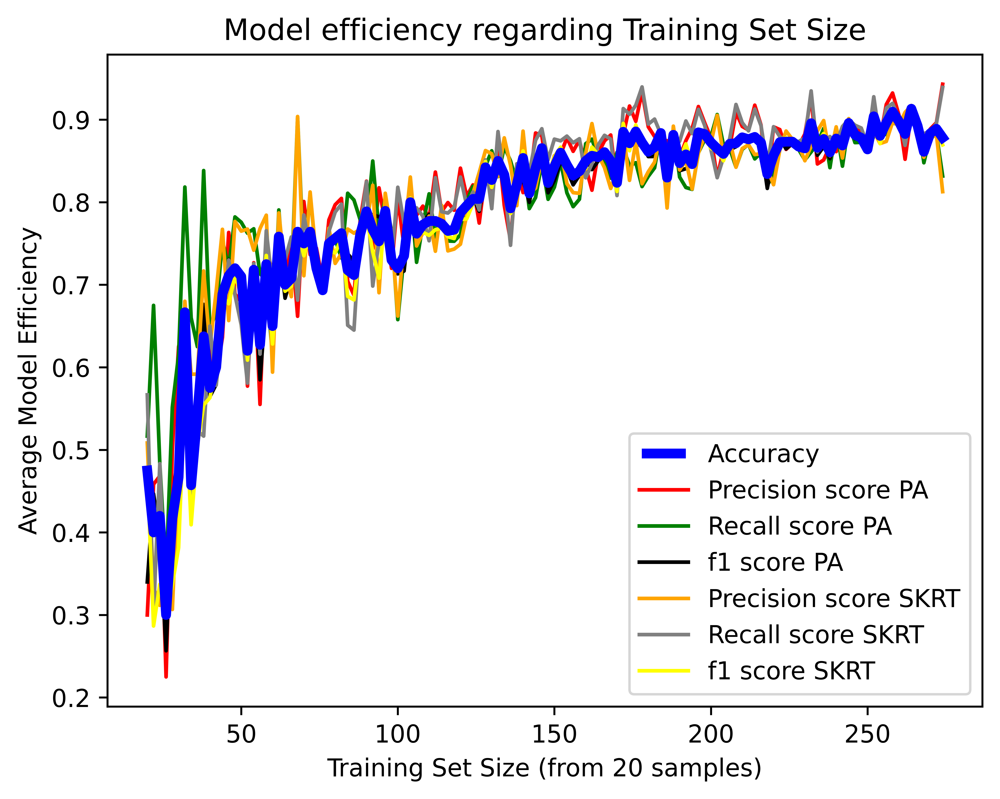

In [ ]:
######################################################################
#                                                                    #
#                 E F F I C I E N C Y  A N A L Y S Y S               #
#             T R A I N I N G  S E T  S I Z E  I M P A C T           #
#   (T R A I N I N G  S E T  I N C R E A S E D  G R A D U A L L Y)   #
#                                                                    #
######################################################################
# Testing model accuracy with increasing training set size
# Training set size will be increased gradually by 2 samples at each loop, starting from 20
# For each training set size, the model is run number_of_runs times and the average accuracy is computed

number_of_runs = 100
min_training_size = 20
max_training_size = len(bombay_embeddings)
total_results = defaultdict(list)

for training_size in tqdm(range(min_training_size, max_training_size, 2), colour='yellow'):
    # Create subset of embeddings with the specific training size
    subset_embeddings = bombay_embeddings.head(training_size)
    
    total_report = defaultdict(int)
    for run in range(0, number_of_runs):   
        single_rf = single_random_forest(subset_embeddings, embedding_cols, n_estimators=50, criterion='gini', max_depth=5)
        total_report = {k: total_report[k] + single_rf.report[k] for k in total_report.keys() | single_rf.report.keys()}

    [ total_results[k].append(total_report[k] / number_of_runs) for k in total_report.keys() ]

#plot_model_efficiency(len(range(min_training_size, max_training_size, 2))+1, 'Training Set Size', f'(Starting from {min_training_size} samples)', total_results)

title = "Model efficiency regarding Training Set Size"
xlabel = "Training Set Size (from 20 samples)"
x_axe = list(range(min_training_size, max_training_size, 2))
plt.figure(dpi=1200)
line1, = plt.plot(x_axe, total_results['accuracy'], color="b", label="Accuracy",  linewidth=4, zorder=9)
 
line2, = plt.plot(x_axe, total_results['precision_score_PA'], color="red", label="Precision score PA")
line3, = plt.plot(x_axe, total_results['recall_score_PA'], color="green", label="Recall score PA")
line4, = plt.plot(x_axe, total_results['f1_score_PA'], color='black', label="f1 score PA")

line5, = plt.plot(x_axe, total_results['precision_score_SKRT'], color="orange", label="Precision score SKRT")
line6, = plt.plot(x_axe, total_results['recall_score_SKRT'], color="gray", label="Recall score SKRT")
line7, = plt.plot(x_axe, total_results['f1_score_SKRT'], color='yellow', label="f1 score SKRT")
        
plt.title(title)
plt.legend(handler_map={line1: HandlerLine2D(numpoints=2)})
plt.xlabel(xlabel)
plt.ylabel('Average Model Efficiency')
plt.show()

### Cumulative errors in many runs: Random Forest n-times

In [ ]:
#########################################################
#                                                       #
#              C U M U L A T I V E  R U N               #
#      R A N D O M  F O R E S T  C L A S S I F I E R    #
#                                                       #
#########################################################
# We will run random forest classifier n_times, each time on different datasets
from collections import Counter

def cumulative_run(set_of_embeddings, n_runs):
    total_accuracy = 0
    error_counts = Counter()
    cumulative_errors = set_of_embeddings.copy()
    cumulative_errors.insert(loc = 5, column = 'Errors', value = 0)

    def R_Forest(X_train, y_train):

        rf = RandomForestClassifier(n_estimators = 50, max_depth=10)
        rf.fit(X_train, y_train)
        
        return rf

    for i in tqdm(range(0, n_runs), colour='yellow'):
        data_train = set_of_embeddings.sample(frac = 0.80)
        X_train = data_train[embedding_cols]
        y_train = data_train["Origin_code"]

        data_test = set_of_embeddings.drop(data_train.index)
        X_test = data_test[embedding_cols]
        y_test = data_test["Origin_code"]
    
        rf = R_Forest(X_train, y_train)
        y_pred = rf.predict(X_test)
        total_accuracy += accuracy_score(y_test, y_pred)
        
        ### Calculate misspredictions for each word
        errors_mask = (y_test != y_pred).astype(int)
        for word, error in zip(data_test['Word'], errors_mask):
            error_counts[word] += error

    mean_accuracy = total_accuracy / n_runs
    print(f'Mean accuracy: {mean_accuracy}')
    cumulative_errors['Errors'] = cumulative_errors['Word'].map(error_counts)
    cumulative_errors = cumulative_errors.sort_values(by=['Errors'], ascending=False)
    return cumulative_errors

In [ ]:
bombay_cumulative_errors = cumulative_run(bombay_embeddings, 100000)
bombay_cumulative_errors.head()

100%|██████████| 1000/1000 [01:04<00:00, 15.57it/s]

Mean accuracy: 0.8898518518518546


,Word,Meaning,Origin,Origin_code,POS,Errors,Similarity,Freq,Freq_diff,0,...,190,191,192,193,194,195,196,197,198,199
139,चिठ्ठी,letter,SKRT,1,noun,215,0.694401,2095,-10787,1.765788,...,2.365758,-0.434059,-0.520185,-1.580319,0.828393,1.499141,-0.104229,-1.130804,-2.001183,-0.015743
77,सपना,"dream, vision",SKRT,1,noun,211,0.735577,49078,31103,-1.584878,...,0.323128,-3.116827,-1.439775,0.959530,-0.637492,2.653821,-1.095388,2.475338,0.883816,0.389385
14,और,and,PA,0,adv,194,0.737813,12011301,11253006,-0.468487,...,-1.412034,0.405375,0.142266,0.433743,1.744014,-0.050413,-0.944879,0.304830,1.112495,-0.839763
257,पानी,water,SKRT,1,noun,188,0.315244,367779,365546,0.264200,...,1.738740,-0.401826,-2.586583,2.355338,-1.091896,-3.002121,4.638252,-1.825394,3.858124,-2.078846
195,वास्तविकता,reality,PA,0,noun,187,0.726934,18326,-12713,-0.514731,...,-0.902573,-0.035719,-0.673863,0.188094,1.005986,-0.583431,-1.801933,1.349442,1.003137,1.286688


### Misclassifications correlated to word origin:

In [ ]:
analyze_errors(bombay_cumulative_errors)

+--------------------------------------------------------------------------------------------+
|                       First 10 words most prone to misclassification                       |
+--------------+-------------------+-----------------+-------------------+-------------------+
| Total Errors | Total SKRT Errors | Total PA Errors |   % SKRT Errors   |    % PA Errors    |
+--------------+-------------------+-----------------+-------------------+-------------------+
|     1780     |        909        |       871       | 51.06741573033708 | 48.93258426966292 |
+--------------+-------------------+-----------------+-------------------+-------------------+
+----------------------------------------------------------------------------------------------+
|                        First 20 words most prone to misclassification                        |
+--------------+-------------------+-----------------+--------------------+--------------------+
| Total Errors | Total SKRT Errors | Total P

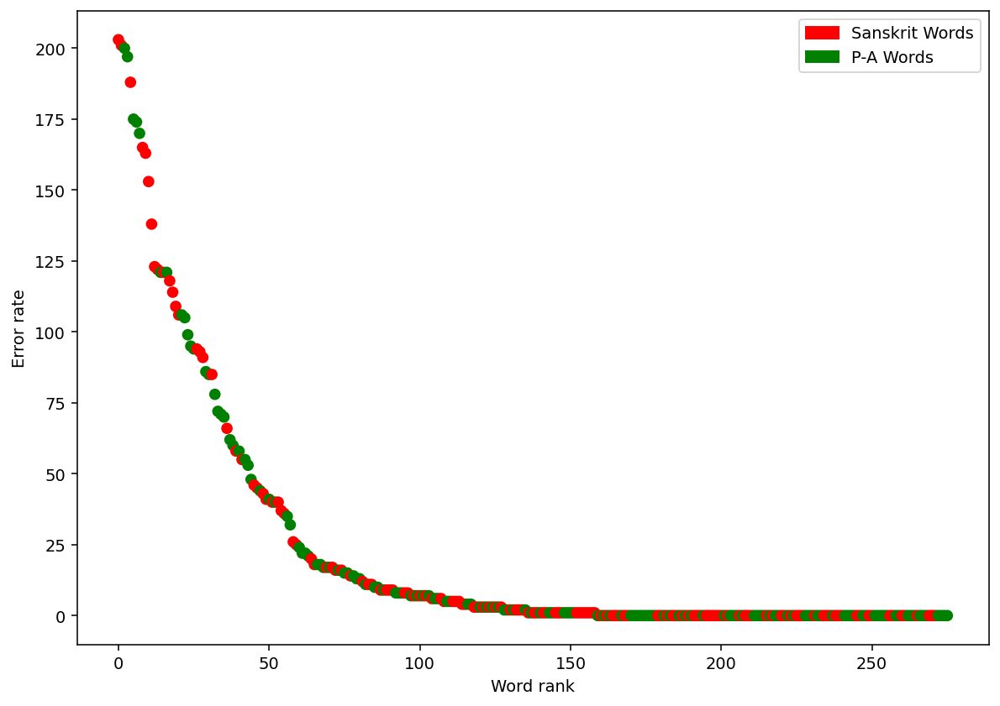

In [ ]:
display_errors(bombay_cumulative_errors)

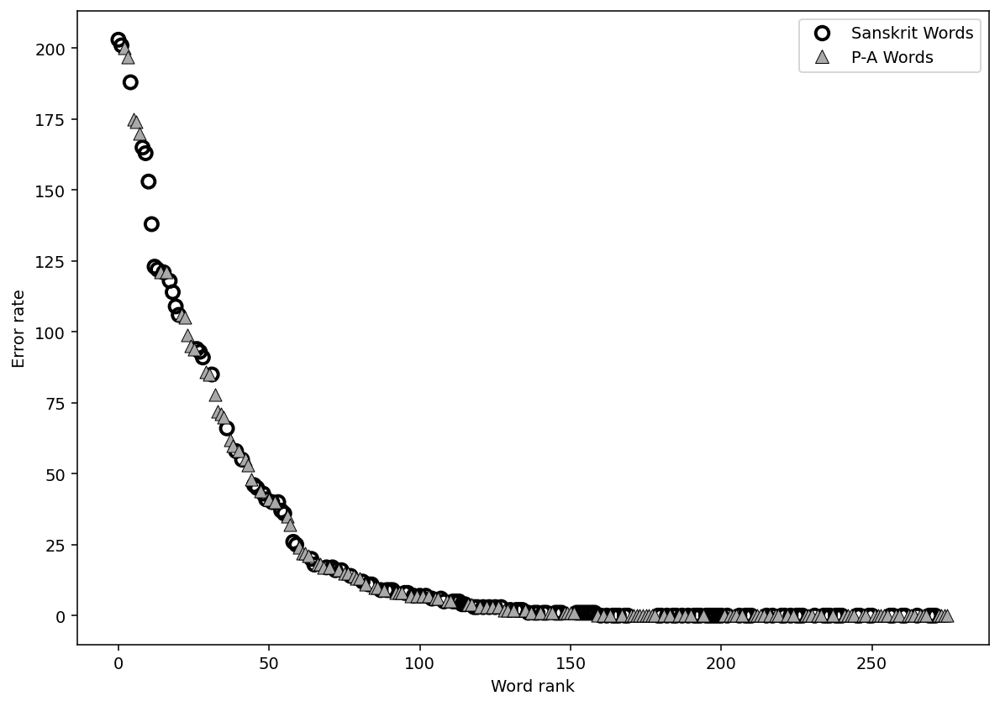

In [ ]:
# Grayscale version for print publication
display_errors(bombay_cumulative_errors, grayscale=True)

In [ ]:
bombay_cumulative_errors.head(100)

,Word,Meaning,Origin,Origin_code,POS,Errors,Similarity,Freq,Freq_diff,0,...,190,191,192,193,194,195,196,197,198,199
263,पानी,water,SKRT,1,noun,203,0.315244,367779,365546,0.264200,...,1.738740,-0.401826,-2.586583,2.355338,-1.091896,-3.002121,4.638252,-1.825394,3.858124,-2.078846
143,चिठ्ठी,letter,SKRT,1,noun,201,0.694401,2095,-10787,1.765788,...,2.365758,-0.434059,-0.520185,-1.580319,0.828393,1.499141,-0.104229,-1.130804,-2.001183,-0.015743
14,और,and,PA,0,adv,200,0.737813,12011301,11253006,-0.468487,...,-1.412034,0.405375,0.142266,0.433743,1.744014,-0.050413,-0.944879,0.304830,1.112495,-0.839763
199,वास्तविकता,reality,PA,0,noun,197,0.726934,18326,-12713,-0.514731,...,-0.902573,-0.035719,-0.673863,0.188094,1.005986,-0.583431,-1.801933,1.349442,1.003137,1.286688
81,सपना,"dream, vision",SKRT,1,noun,188,0.735577,49078,31103,-1.584878,...,0.323128,-3.116827,-1.439775,0.959530,-0.637492,2.653821,-1.095388,2.475338,0.883816,0.389385
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22,ख़ूबसूरत,beautiful,PA,0,adj,8,0.808898,54827,-92732,3.777995,...,-0.453605,2.209011,0.366267,0.055109,-0.530082,1.693171,2.382280,-2.767141,-0.138197,-1.625694
44,ज़ाहिर,"clear, evident",PA,0,adj,8,0.583959,69188,-53567,-1.057355,...,0.005491,-1.925394,-0.021135,-2.069970,0.656875,-3.086660,-1.454669,0.539383,0.965688,1.957245
122,उम्मीद,"hope, expectation",PA,0,noun,7,0.786830,132850,56810,0.059257,...,-3.475702,-0.967128,-0.990991,-0.022991,-1.420554,-0.406535,-1.174324,2.288806,3.366313,2.320989
1,अनुसार,according to,SKRT,1,ppos,7,0.888792,315271,180712,-0.708375,...,0.485142,-3.224078,-0.217975,-2.676085,-0.267757,-2.144358,-4.470402,0.347183,0.428601,-0.299248


In [ ]:
# Correlation matrix number of errors / other parameters
columns = ['Errors', 'Origin_code', 'Similarity', 'Freq', 'Freq_diff']

# Display color version
display_correlation_matrix(bombay_cumulative_errors, columns, title='Correlation Matrix for Bombay Corpus Cumulative Errors')

In [ ]:
# Display grayscale version for print
display_correlation_matrix(bombay_cumulative_errors, columns, title='Correlation Matrix for Bombay Corpus Cumulative Errors', grayscale=True)

### Cumulative run without words most prone to misclassification

In [ ]:
# Building the new vocabulary
new_bombay_embeddings = bombay_embeddings.copy()
most_prone_to_errors = bombay_cumulative_errors.copy()[0:20]
print(f'Length of the whole vocabulary: {len(new_bombay_embeddings)}')
print(f'Number of the most prone to misclassification words: {len(most_prone_to_errors)}')
best_bombay_embeddings = new_bombay_embeddings[ ~new_bombay_embeddings['Word'].isin(most_prone_to_errors['Word'])]
print(f'Length of the best vocabulary: {len(best_bombay_embeddings)}')

Length of the whole vocabulary: 276
Number of the most prone to misclassification words: 20
Length of the best vocabulary: 256


In [ ]:
######################################################################################################################################
#                                                                                                                                    #
#      R A N D O M  F O R E S T  C L A S S I F I E R  W I T H O U T  T H E  M O S T  P R O N E  T O  E R R O R S  W O R D S          #
#                                                                                                                                    #
######################################################################################################################################

new_bombay_cumulative_errors = cumulative_run(best_bombay_embeddings, 100000)

100%|██████████| 1000/1000 [00:51<00:00, 19.54it/s]

Mean accuracy: 0.9445882352941242


In [ ]:
new_bombay_cumulative_errors.head()

,Word,Meaning,Origin,Origin_code,POS,Errors,Similarity,Freq,Freq_diff,0,...,190,191,192,193,194,195,196,197,198,199
7,विरोध,against,SKRT,1,ppos,142,0.485061,173102,-120594,-3.650904,...,2.405693,-1.717246,1.561909,-0.814622,1.341522,0.426760,1.167670,1.678947,0.177638,2.976579
93,परिवार,family,SKRT,1,noun,120,0.630688,325241,318151,-2.185799,...,-0.547288,-3.054879,-2.504970,-2.374631,0.889892,-0.447310,-0.211489,-1.010767,3.578674,3.401034
225,मूर्ख,stupid,SKRT,1,adj,118,0.851030,14922,5668,0.172178,...,-0.985176,1.100556,1.151401,-1.811532,0.757023,-1.098527,-0.341210,1.798830,-0.297258,-1.014897
16,इलाक़ा,area,PA,0,noun,107,0.700162,135876,-323739,-1.653669,...,3.178074,-0.990350,-0.582151,1.035959,-3.425886,-0.040577,4.307960,1.079741,2.895336,0.749246
25,शुरुआत,beginning,SKRT,1,noun,93,0.485949,128010,122058,-2.369755,...,-0.580215,1.103633,0.053941,-2.786235,-2.023472,2.068062,1.341900,-0.043809,1.273046,2.580275


In [ ]:
analyze_errors(new_bombay_cumulative_errors)

+--------------------------------------------------------------------------------------------+
|                       First 10 words most prone to misclassification                       |
+--------------+-------------------+-----------------+-------------------+-------------------+
| Total Errors | Total SKRT Errors | Total PA Errors |   % SKRT Errors   |    % PA Errors    |
+--------------+-------------------+-----------------+-------------------+-------------------+
|     1003     |        636        |       367       | 63.40977068793619 | 36.59022931206381 |
+--------------+-------------------+-----------------+-------------------+-------------------+
+----------------------------------------------------------------------------------------------+
|                        First 20 words most prone to misclassification                        |
+--------------+-------------------+-----------------+--------------------+--------------------+
| Total Errors | Total SKRT Errors | Total P

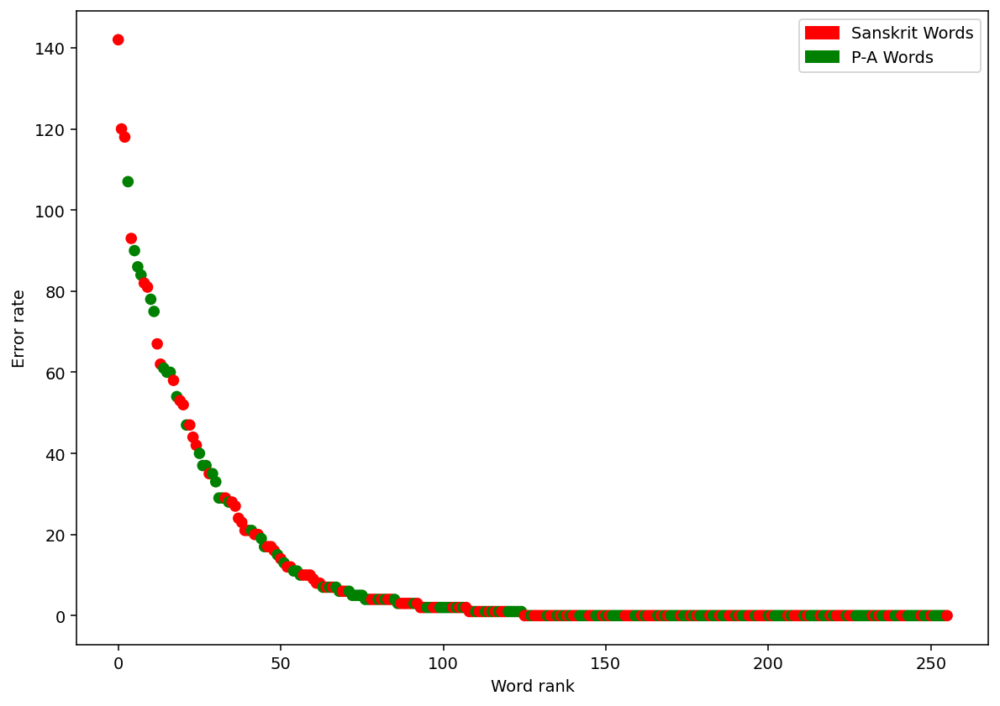

In [ ]:
display_errors(new_bombay_cumulative_errors)

In [ ]:
# Correlation matrix number of errors / other parameters
columns = ['Errors', 'Origin_code', 'Similarity', 'Freq', 'Freq_diff']

# Display color version
display_correlation_matrix(new_bombay_cumulative_errors, columns, title='Correlation Matrix — Bombay Corpuswithout Most Prone to Errors Words')

In [ ]:
# Grayscale version for print publication
display_correlation_matrix(new_bombay_cumulative_errors, columns, title='Correlation Matrix — Bombay Corpus without Most Prone to Errors Words', grayscale=True)

# Verification on the control corpus

## Checking if the same words are prone to misclassification in both corpora

In [ ]:
# Load the Hitenten model
HITENTEN_FILE = "models/hindi/hitenten_200.model"
model_loaded_hitenten = load_model(HITENTEN_FILE)
hitenten_embeddings, hitenten_embedding_cols, embeddings_mapping_dict = Vocabulary.build_embeddings(raw_vocabulary, model_loaded_hitenten)
print(f'Number of embeddings: {len(hitenten_embeddings)}')

+------------------------------------------------------------------------------------------------------------------------------------+
|                                                      W2V Model Specifications                                                      |
+-------------+--------------+--------------------+-----------+---------------------+--------+------------------+--------------------+
| Vector Size | Corpus count | Corpus total words | Min count | Effective min count | Epochs | Total train time |      Filename      |
+-------------+--------------+--------------------+-----------+---------------------+--------+------------------+--------------------+
|     200     |  3,750,447   |    109,945,018     |     10    |          10         |   5    |     576.48s      | hitenten_200.model |
+-------------+--------------+--------------------+-----------+---------------------+--------+------------------+--------------------+
+------------------------------------------------------

In [ ]:
hitenten_cumulative_errors = cumulative_run(hitenten_embeddings, 100000)

100%|██████████| 1000/1000 [01:04<00:00, 15.41it/s]

Mean accuracy: 0.8891481481481521


In [ ]:
display_jaccard_indexes(bombay_cumulative_errors, hitenten_cumulative_errors, len(hitenten_embeddings))

+--------------------------------------------------------------------------------------------------------------------------------+
|                                    Jaccard Index for words most prone to misclassification                                     |
+-----------------+-----------------+-------------------+---------------------+----------------------+---------------------------+
|  X first words  | Common elements | Union of elements |    Jaccard Coef.    |   Expected Jaccard   | Probability of the result |
+-----------------+-----------------+-------------------+---------------------+----------------------+---------------------------+
|  10 first words |     7 words     |      13 words     |  0.5384615384615384 | 0.018867924528301886 |        0.0000001222       |
|  20 first words |     12 words    |      28 words     | 0.42857142857142855 | 0.03846153846153846  |        0.0000000440       |
|  30 first words |     19 words    |      41 words     |  0.4634146341463415 | 0.0